In [1]:
import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pickle

In [2]:
print(torch.cuda.is_available())

True


In [3]:
# Проверяем, доступны ли GPU
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [19]:
# Загрузка DataFrame из файла
with open(r'./datasets/seg_maps_dataset.pkl', 'rb') as f:
    df = pickle.load(f)

In [5]:
df = df.loc[df['Stats'].isin([1.e+08, 2.e+08, 5.e+08])]

df['Stats'].unique()

array([1.e+08, 2.e+08, 5.e+08])

In [20]:
df = df.loc[df['Stats'].isin([5.e+08])]
df = df[~df['Crystal'].isin(['C_diamond', 'Cr', 'Cu', 'Fe', 'Ni', 'Ti'])]

print(df['Stats'].unique())
print(df['Crystal'].unique())

[5.e+08]
['Al' 'Al2O3_sapphire' 'Ba' 'Be' 'BeO' 'C_graphite' 'Cs' 'Cu2MnAl' 'Ga'
 'Ge' 'He4_hcp' 'I2' 'K' 'Mo' 'Na2Ca3Al2F14' 'Nb' 'Pb' 'Pt' 'Rb' 'Si' 'Tl'
 'UO2' 'Zn' 'Y2O3']


In [21]:
crystals = np.array(df['Crystal'].unique())

df['Crystal'].unique()

array(['Al', 'Al2O3_sapphire', 'Ba', 'Be', 'BeO', 'C_graphite', 'Cs',
       'Cu2MnAl', 'Ga', 'Ge', 'He4_hcp', 'I2', 'K', 'Mo', 'Na2Ca3Al2F14',
       'Nb', 'Pb', 'Pt', 'Rb', 'Si', 'Tl', 'UO2', 'Zn', 'Y2O3'],
      dtype=object)

In [22]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

X = df.drop(['Crystal', 'Stats', 'Pulce duration'], axis=1)

# Шаг 1: Преобразование строковых меток классов в числовые метки
label_encoder = LabelEncoder()

Stats = df['Stats']

y = df['Crystal']

y_encoded = label_encoder.fit_transform(y)

Diff_train, Diff_test, Stats_train, Stats_test, y_train, y_test = train_test_split(X, Stats, y_encoded, test_size=0.1, random_state=42)

In [23]:
import torch.nn.functional as F

# Преобразование матриц в numpy массив перед преобразованием в тензоры
Diff_train_matrices = np.array(Diff_train['Matrix'].tolist())
Diff_test_matrices = np.array(Diff_test['Matrix'].tolist())

Stats_train_matrices = np.array(Stats_train.tolist())
Stats_test_matrices = np.array(Stats_test.tolist())

# Преобразование данных в тензоры PyTorch
Diff_train_tensor = torch.FloatTensor(Diff_train_matrices)
Diff_train_tensor = Diff_train_tensor.unsqueeze(1)
#Diff_train_tensor = F.interpolate(Diff_train_tensor, size=(256, 480), mode='bicubic', align_corners=False)
Diff_train_tensor = Diff_train_tensor * 2.0 - 1.0
Stats_train_tensor = torch.FloatTensor(Stats_train_matrices)

y_train_tensor = torch.LongTensor(y_train)  # Используем LongTensor для целевых меток

Diff_test_tensor = torch.FloatTensor(Diff_test_matrices)
Diff_test_tensor = Diff_test_tensor.unsqueeze(1)
#Diff_test_tensor = F.interpolate(Diff_test_tensor, size=(256, 480), mode='bicubic', align_corners=False)
Diff_test_tensor = Diff_test_tensor * 2.0 - 1.0
Stats_test_tensor = torch.FloatTensor(Stats_test_matrices)

y_test_tensor = torch.LongTensor(y_test)

In [24]:
print(Diff_train_tensor.size())
print(Diff_test_tensor.size())

torch.Size([432, 1, 250, 480])
torch.Size([48, 1, 250, 480])


In [25]:
from torch.utils.data import TensorDataset, DataLoader, random_split

# Создание набора данных
train_dataset = TensorDataset(Diff_train_tensor, y_train_tensor)

test_dataset = TensorDataset(Diff_test_tensor, y_test_tensor)

# Создание DataLoader для каждой выборки
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)

test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

# Initialization of a Two-Dimensional Conditional ViT VAE

In [ ]:
from Spatial_Conditional_ViT_VAE_model import ViTVAEForLatentMaps

device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Model configuration
model = ViTVAEForLatentMaps(
    img_size=(250, 480),
    patch_size=(10, 16),  # 25x30 patches
    in_channels=1,
    embed_dim=512,
    depth=6,
    num_heads=8,
    num_classes=30,
    latent_channels=32,
    dropout=0.1
).to(device)

# model.load_state_dict(torch.load("models/Conditional_ViT_VAE_bound_state.pth"))
model.load_state_dict(torch.load("models/Conditional_ViT_VAE_bound_state_fine_tuned.pth"))

# fake batch
# data = torch.randn(4, 1, 250, 480, device=device)
# labels = torch.randint(0, 20, (4,), device=device)

# recon_data, mean, logvar = model(data, labels)

# print(recon_data.size(), mean.size(), logvar.size())

<All keys matched successfully>

# Initialization of a Two-Dimensional UnConditional ViT VAE

In [ ]:
from Sapatial_UnConditional_ViT_VAE_model import ViTVAEForLatentMaps

device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Model configuration
model = ViTVAEForLatentMaps(img_size=(250, 480), patch_size=(10, 16), in_channels=1,
                 embed_dim=512, depth=6, num_heads=8, mlp_ratio=2.0,
                 latent_channels=32, dropout=0.1).to(device)

model.load_state_dict(torch.load("models/Conditional_ViT_VAE_bound_state.pth"))

# fake batch
# data = torch.randn(4, 1, 250, 480, device=device)
# labels = torch.randint(0, 20, (4,), device=device)

# recon_data, mean, logvar = model(data)

# print(recon_data.size(), mean.size(), logvar.size())

RuntimeError: Error(s) in loading state_dict for ViTVAEForLatentMaps:
	Missing key(s) in state_dict: "encoder.pos_embed", "decoder.pos_embed". 
	Unexpected key(s) in state_dict: "encoder.class_embed.class_embed.weight", "encoder.pos_embed.pos_embed", "decoder.class_embed.class_embed.weight", "decoder.pos_embed.pos_embed". 
	size mismatch for encoder.blocks.0.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for encoder.blocks.0.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for encoder.blocks.0.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for encoder.blocks.1.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for encoder.blocks.1.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for encoder.blocks.1.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for encoder.blocks.2.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for encoder.blocks.2.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for encoder.blocks.2.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for encoder.blocks.3.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for encoder.blocks.3.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for encoder.blocks.3.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for encoder.blocks.4.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for encoder.blocks.4.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for encoder.blocks.4.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for encoder.blocks.5.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for encoder.blocks.5.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for encoder.blocks.5.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for decoder.blocks.0.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for decoder.blocks.0.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for decoder.blocks.0.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for decoder.blocks.1.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for decoder.blocks.1.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for decoder.blocks.1.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for decoder.blocks.2.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for decoder.blocks.2.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for decoder.blocks.2.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for decoder.blocks.3.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for decoder.blocks.3.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for decoder.blocks.3.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for decoder.blocks.4.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for decoder.blocks.4.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for decoder.blocks.4.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).
	size mismatch for decoder.blocks.5.mlp.0.weight: copying a param with shape torch.Size([2048, 512]) from checkpoint, the shape in current model is torch.Size([1024, 512]).
	size mismatch for decoder.blocks.5.mlp.0.bias: copying a param with shape torch.Size([2048]) from checkpoint, the shape in current model is torch.Size([1024]).
	size mismatch for decoder.blocks.5.mlp.3.weight: copying a param with shape torch.Size([512, 2048]) from checkpoint, the shape in current model is torch.Size([512, 1024]).

# Initializing ResNet-18 classifier to calculate IS and FID metrics

In [12]:
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models

# Загружаем предобученную ResNet18
classifier = models.resnet18(pretrained=True)

# Изменяем первый сверточный слой
classifier.conv1 = nn.Conv2d(1, 64, kernel_size=7, stride=2, padding=3, bias=False)

# Изменяем последний полносвязный слой для вашего количества классов
num_ftrs = classifier.fc.in_features
classifier.fc = nn.Linear(num_ftrs, len(crystals))

classifier.to(device)

classifier.load_state_dict(torch.load("models/ResNet_18_classifier_diffractions.pth"))

C:\Users\neUral\AppData\Roaming\Python\Python312\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
C:\Users\neUral\AppData\Roaming\Python\Python312\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


<All keys matched successfully>

# Calculating metrics

In [15]:
from tqdm import tqdm
from torchmetrics.image import PeakSignalNoiseRatio, StructuralSimilarityIndexMeasure

def denorm(x):
    return (x + 1) / 2

# Инициализируем метрики
psnr_metric = PeakSignalNoiseRatio(data_range=1.0).to(device)  # data_range=1.0 для диапазона [0, 1]
ssim_metric = StructuralSimilarityIndexMeasure(data_range=1.0).to(device)

psnr_values = []
ssim_values = []

model.eval()
with torch.no_grad():
    for data, labels in tqdm(train_loader):

        data = data.to(device)
        labels = labels.to(device)

        # Sample from prior distribution
        z = torch.randn(data.size(0), 32, 25, 30).to(device)
        generated = model.decoder(z, labels)

        # ---- denorm ----
        data_01 = denorm(data).clamp(0, 1)
        gen_01  = denorm(generated).clamp(0, 1)

        # ---- PSNR ----
        psnr_val = psnr_metric(data_01, gen_01)
        psnr_values.append(psnr_val.item())

        # ---- SSIM ----
        ssim_val = ssim_metric(data_01, gen_01)
        ssim_values.append(ssim_val.item())

N = len(psnr_values)
psnr_values = np.array(psnr_values)
ssim_values = np.array(ssim_values)

# Бутстрэп параметры
num_bootstraps = 1000  # Количество итераций; 1000–5000 для хорошей точности, но дольше считается

boot_PSNR = []
boot_SSIM = []
np.random.seed(42)  # Для воспроизводимости
for _ in tqdm(range(num_bootstraps)):
    # Семплируем с возвращением индексы
    indices = np.random.choice(N, size=N, replace=True)
    boot_preds_PSNR = psnr_values[indices]
    boot_preds_SSIM = ssim_values[indices]
    
    boot_PSNR.append(np.mean(boot_preds_PSNR))
    boot_SSIM.append(np.mean(boot_preds_SSIM))


# Финальные результаты
mean_PSNR = np.mean(boot_PSNR)
ci_low, ci_high = np.percentile(boot_PSNR, [2.5, 97.5])

print(f'Mean PSNR: {mean_PSNR}, db')
print(f'95% Confidence Interval: [{ci_low}, {ci_high}], db')

mean_SSIM = np.mean(boot_SSIM)
ci_low, ci_high = np.percentile(boot_SSIM, [2.5, 97.5])

print(f'Mean SSIM: {mean_SSIM}')
print(f'95% Confidence Interval: [{ci_low}, {ci_high}]')

100%|██████████| 1000/1000 [00:00<00:00, 38737.87it/s]

Mean PSNR: 20.31366235582917, db
95% Confidence Interval: [20.016669694361862, 20.592154824380522], db
Mean SSIM: 0.791854651025048
95% Confidence Interval: [0.7840538465093683, 0.7987768400184534]


# Inception Score

In [16]:
import torch
import torch.nn.functional as F
import numpy as np
from scipy.stats import entropy
from tqdm import tqdm

# Предполагаем, что classifier, model, device, train_loader определены как в вашем коде

classifier.eval()
preds = []
with torch.no_grad():
    for data, labels in tqdm(train_loader):
        data = data.to(device)
        labels = labels.to(device)
        # Sample from prior distribution
        z = torch.randn(data.size(0), 32, 25, 30).to(device)
        generated = model.decoder(z, labels)
        outputs = classifier(generated)
        probs = F.softmax(outputs, dim=1).cpu().numpy()
        preds.append(probs)

preds = np.concatenate(preds, axis=0)
N = preds.shape[0]

# Бутстрэп параметры
num_bootstraps = 1000  # Количество итераций; 1000–5000 для хорошей точности, но дольше считается

boot_scores = []
np.random.seed(42)  # Для воспроизводимости
for _ in tqdm(range(num_bootstraps)):
    # Семплируем с возвращением индексы
    indices = np.random.choice(N, size=N, replace=True)
    boot_preds = preds[indices]
    
    # Вычисляем IS для бутстрэп-выборки
    py = np.mean(boot_preds, axis=0)
    kl_divs = [entropy(p_yx, py) for p_yx in boot_preds]
    boot_is = np.exp(np.mean(kl_divs))
    boot_scores.append(boot_is)

# Финальные результаты
mean_is = np.mean(boot_scores)
ci_low, ci_high = np.percentile(boot_scores, [2.5, 97.5])

print(f'Mean ResNet (Inception) Score: {mean_is}')
print(f'95% Confidence Interval: [{ci_low}, {ci_high}]')

100%|██████████| 1000/1000 [01:16<00:00, 13.07it/s]

Mean ResNet (Inception) Score: 23.499496459960938
95% Confidence Interval: [22.49017252922058, 24.50463843345642]


# FID

100%|██████████| 1080/1080 [00:14<00:00, 76.09it/s]


Class Al: Mean FID = 25.27811729540859, 95% CI = [21.996866242530864, 29.62621723758044]
Class Al2O3_sapphire: Mean FID = 42.48077976134539, 95% CI = [39.78060398595086, 45.45706989775547]
Class Ba: Mean FID = 14.671534597549282, 95% CI = [11.810051806910495, 19.029839994225753]
Class Be: Mean FID = 41.03975765088534, 95% CI = [38.24929978753481, 44.79829248271725]
Class BeO: Mean FID = 43.12686904568321, 95% CI = [38.05702887053146, 49.29465378286497]
Class C_diamond: Mean FID = 39.78300655244202, 95% CI = [36.624835532736085, 42.85984286610529]
Class C_graphite: Mean FID = 52.14550344919936, 95% CI = [48.40850749080504, 56.3292544259396]
Class Cr: Mean FID = 356.82989072920117, 95% CI = [347.1707191433357, 366.97258797821144]
Class Cs: Mean FID = 12.12950323387348, 95% CI = [9.749834189161758, 15.539907815026643]
Class Cu: Mean FID = 72.3638733580301, 95% CI = [65.72650371796051, 78.87616179727618]
Class Cu2MnAl: Mean FID = 36.565922610146046, 95% CI = [32.07898046021637, 41.53886992

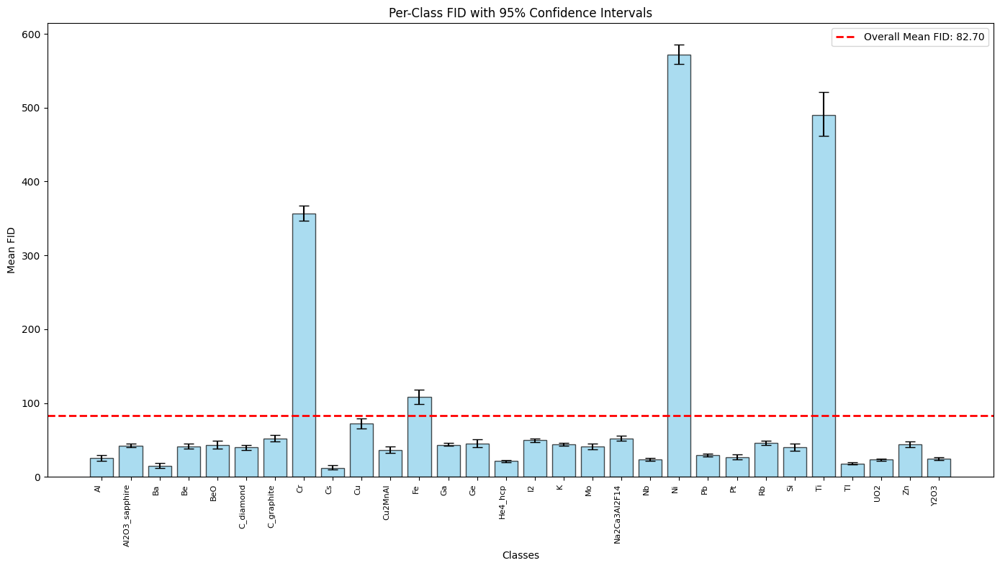

In [32]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
from scipy.linalg import sqrtm
from tqdm import tqdm

# Ваш FeatureExtractor (как вы процитировали)
class FeatureExtractor(nn.Module):
    def __init__(self, classifier):
        super().__init__()
        self.features = nn.Sequential(*list(classifier.children())[:-1])  # До fc-слоя
    
    def forward(self, x):
        x = self.features(x)
        return x.view(x.size(0), -1)  # [B, 512]

# Предполагаем, что classifier, model, device, train_loader определены
extractor = FeatureExtractor(classifier).to(device)
extractor.eval()

real_features_dict = {c: [] for c in range(30)}  # Per class: списки для real feats
gen_features_dict = {c: [] for c in range(30)}   # Per class: списки для gen feats

with torch.no_grad():
    for data, labels in tqdm(train_loader):
        data = data.to(device)
        labels = labels.to(device)
        
        # Real features
        real_feats = extractor(data).cpu().numpy()
        
        # Generated features
        z = torch.randn(data.size(0), 32, 25, 30).to(device)
        generated = model.decoder(z, labels)
        gen_feats = extractor(generated).cpu().numpy()
        
        # Группируем по labels (batch_size=1, так что по одному)
        for i in range(data.size(0)):
            c = labels[i].item()
            real_features_dict[c].append(real_feats[i])
            gen_features_dict[c].append(gen_feats[i])

# Конвертируем списки в np.arrays для удобства
for c in range(30):
    if real_features_dict[c]:
        real_features_dict[c] = np.stack(real_features_dict[c])
    else:
        real_features_dict[c] = np.empty((0, 512))
    
    if gen_features_dict[c]:
        gen_features_dict[c] = np.stack(gen_features_dict[c])
    else:
        gen_features_dict[c] = np.empty((0, 512))

# Функция для расстояния Фреше (как раньше)
def calculate_frechet_distance(mu1, sigma1, mu2, sigma2, eps=1e-6):
    diff = mu1 - mu2
    covmean = sqrtm(sigma1.dot(sigma2))
    if np.iscomplexobj(covmean):
        covmean = covmean.real
    return diff.dot(diff) + np.trace(sigma1 + sigma2 - 2 * covmean) + eps

# Бутстрэп для per-class FID
num_bootstraps = 300  # Как в IS
np.random.seed(42)

per_class_results = {}
for c in range(30):
    real_feats = real_features_dict[c]
    gen_feats = gen_features_dict[c]
    
    N_real = len(real_feats)
    N_gen = len(gen_feats)
    
    if N_real < 2 or N_gen < 2:  # Нужно минимум для cov
        per_class_results[c] = {'mean_fid': float('nan'), 'ci_low': float('nan'), 'ci_high': float('nan')}
        continue
    
    boot_fids = []
    for _ in tqdm(range(num_bootstraps), desc=f"Class Num {c}", leave=False):
        # Бутстрэп для real
        indices_real = np.random.choice(N_real, size=N_real, replace=True)
        boot_real = real_feats[indices_real]
        mu_real = np.mean(boot_real, axis=0)
        sigma_real = np.cov(boot_real, rowvar=False)
        
        # Бутстрэп для gen
        indices_gen = np.random.choice(N_gen, size=N_gen, replace=True)
        boot_gen = gen_feats[indices_gen]
        mu_gen = np.mean(boot_gen, axis=0)
        sigma_gen = np.cov(boot_gen, rowvar=False)
        
        fid = calculate_frechet_distance(mu_real, sigma_real, mu_gen, sigma_gen)
        boot_fids.append(fid)
    
    mean_fid = np.mean(boot_fids)
    ci_low, ci_high = np.percentile(boot_fids, [2.5, 97.5])
    per_class_results[c] = {'mean_fid': mean_fid, 'ci_low': ci_low, 'ci_high': ci_high}

errors_hi = []
errors_lw = []
means = []

# Вывод результатов
for c in range(30):
    res = per_class_results.get(c, {'mean_fid': float('nan'), 'ci_low': float('nan'), 'ci_high': float('nan')})
    print(f'Class {crystals[c]}: Mean FID = {res["mean_fid"]}, 95% CI = [{res["ci_low"]}, {res["ci_high"]}]')
    means.append(res["mean_fid"])
    errors_lw.append(res["mean_fid"] - res["ci_low"])
    errors_hi.append(res["ci_high"] - res["mean_fid"])

errors = np.array([errors_lw, errors_hi])
# Вычисляем средний FID по всем классам
overall_mean = np.mean(means)

# Построение гистограммы (bar plot)
plt.figure(figsize=(14, 8))  # Размер для читаемости
x = np.arange(len(crystals))  # Индексы для баров

plt.bar(x, means, yerr=errors, capsize=5, alpha=0.7, color='skyblue', edgecolor='black')
plt.axhline(y=overall_mean, color='red', linestyle='--', linewidth=2, label=f'Overall Mean FID: {overall_mean:.2f}')

# Настройки осей и меток
plt.xticks(x, crystals, rotation=90, ha='right', fontsize=8)
plt.xlabel('Classes')
plt.ylabel('Mean FID')
plt.title('Per-Class FID with 95% Confidence Intervals')
plt.legend()
plt.tight_layout()  # Чтобы метки не обрезались

# Сохраняем или показываем
# plt.savefig('per_class_fid_histogram.png')  # Сохранить как файл
plt.show()  # Или показать интерактивно

100%|██████████| 1620/1620 [00:14<00:00, 114.33it/s]


Всего образцов: 1620


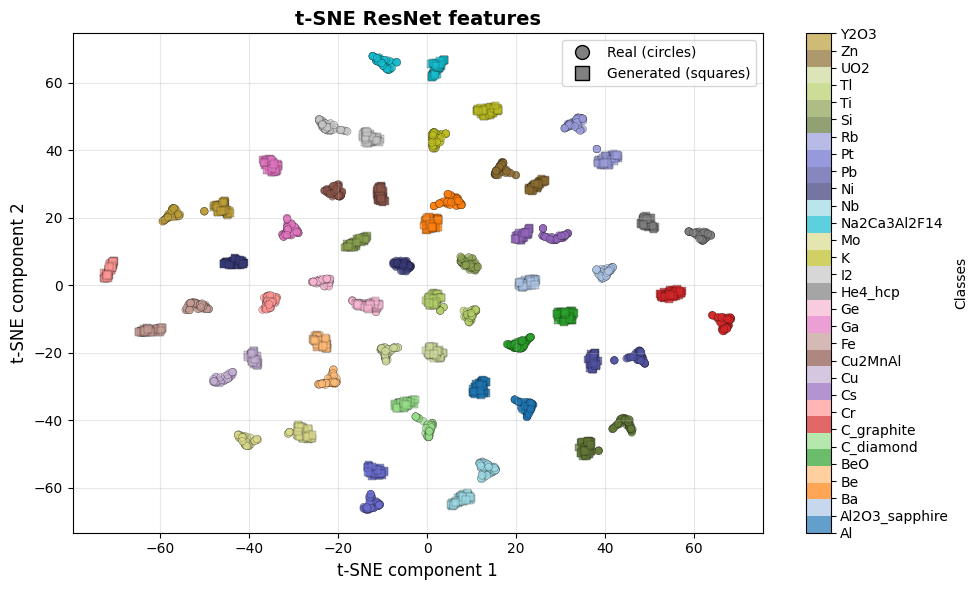

In [17]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.manifold import TSNE
import torch
from tqdm import tqdm
import seaborn as sns

# Ваш FeatureExtractor (как вы процитировали)
class FeatureExtractor(nn.Module):
    def __init__(self, classifier):
        super().__init__()
        self.features = nn.Sequential(*list(classifier.children())[:-1])  # До fc-слоя
    
    def forward(self, x):
        x = self.features(x)
        return x.view(x.size(0), -1)  # [B, 512]

# Предполагаем, что classifier, model, device, train_loader определены
extractor = FeatureExtractor(classifier).to(device)
extractor.eval()

# Устанавливаем цветовую схему для 30 классов
plt.rcParams['axes.prop_cycle'] = plt.cycler(color=plt.cm.tab20.colors)
cmap = plt.cm.tab20  # tab20 имеет 20 цветов, расширим для 30

# Создаем расширенную цветовую палитру для 30 классов
tab20_colors = plt.cm.tab20(np.linspace(0, 1, 20))
tab20b_colors = plt.cm.tab20b(np.linspace(0, 1, 20))
# Берем цвета из обеих палитр
extended_colors = np.vstack([tab20_colors, tab20b_colors[:10]])
cmap_extended = plt.cm.colors.ListedColormap(extended_colors)

classes_names = np.array(df['Crystal'].unique())

real_features = []
gen_features = []
all_labels = []

with torch.no_grad():
    for data, labels in tqdm(train_loader):
        data = data.to(device)
        labels = labels.to(device)
        
        # Real features
        real_feats = extractor(data).cpu()
        
        # Generated features
        z = torch.randn(data.size(0), 32, 25, 30).to(device)
        generated = model.decoder(z, labels)
        gen_feats = extractor(generated).cpu()

        real_features.append(real_feats)
        gen_features.append(gen_feats)
        all_labels.append(labels.cpu())
        
# Объединяем все батчи
real_features = torch.cat(real_features, dim=0).numpy()
all_labels = torch.cat(all_labels, dim=0).numpy()
gen_features = torch.cat(gen_features, dim=0).numpy()

print(f"Всего образцов: {len(all_labels)}")

# Обучаем на всех данных (объединяем real и gen)
all_features = np.vstack([real_features, gen_features])
tsne_all = TSNE(n_components=2, random_state=42, perplexity=30)
all_2d = tsne_all.fit_transform(all_features)

# Разделяем обратно
real_2d = all_2d[:len(real_features)]
gen_2d = all_2d[len(real_features):]

plt.figure(figsize=(10,6))

# Визуализация реальных данных (real) - КРУГЛЫЕ маркеры
scatter1 = plt.scatter(real_2d[:, 0], real_2d[:, 1], 
                       c=all_labels, cmap=cmap_extended, 
                       alpha=0.7, s=30, edgecolors='k', 
                       linewidth=0.2, marker='o')  # 'o' = кружки

# Визуализация сгенерированных данных (gen) - КВАДРАТНЫЕ маркеры
scatter2 = plt.scatter(gen_2d[:, 0], gen_2d[:, 1], 
                       c=all_labels, cmap=cmap_extended, 
                       alpha=0.7, s=30, edgecolors='k', 
                       linewidth=0.2, marker='s')  # 's' = квадраты

# Добавляем легенду с маркерами
from matplotlib.lines import Line2D

# Создаем кастомные элементы для легенды
legend_elements = [
    Line2D([0], [0], marker='o', color='w', markerfacecolor='gray',
           markersize=10, label='Real (circles)', markeredgecolor='k'),
    Line2D([0], [0], marker='s', color='w', markerfacecolor='gray',
           markersize=10, label='Generated (squares)', markeredgecolor='k')
]

# Добавляем легенду
plt.legend(handles=legend_elements, loc='best')

plt.title("t-SNE ResNet features", fontsize=14, fontweight='bold')
plt.xlabel("t-SNE сomponent 1", fontsize=12)
plt.ylabel("t-SNE component 2", fontsize=12)
plt.grid(True, alpha=0.3)

# Цветовая шкала (если нужно)
cbar = plt.colorbar(scatter1, label='Classes')
cbar.set_ticks(np.arange(len(classes_names)))
cbar.set_ticklabels(classes_names)

plt.tight_layout()
plt.show()

# FID anomaly explain

In [14]:
special_indexes = [7, 9, 11, 20, 25]

In [15]:
#array([1.e+07, 2.e+07, 5.e+07, 1.e+08, 2.e+08, 5.e+08])
maxStats = 5.e+08
minI = max(df['Pulce duration'].unique())

df_test = df.loc[((df['Stats'] == maxStats) & (df['Pulce duration'] == minI))]
df_test = df_test.reset_index(drop= True)

Crystal_tags = df_test['Crystal']

Crystal_tags_encoded = label_encoder.fit_transform(Crystal_tags)

Crystal_tags_encoded = torch.LongTensor(Crystal_tags_encoded)
Crystal_tags_encoded = Crystal_tags_encoded.to(device)

# Преобразование матриц в numpy массив перед преобразованием в тензоры
df_test_matrices = np.array(df_test['Matrix'].tolist())

# Преобразование данных в тензоры PyTorch
df_test_tensor = torch.FloatTensor(df_test_matrices)
df_test_tensor = df_test_tensor.unsqueeze(1)
df_test_tensor = df_test_tensor * 2.0 - 1.0

df_test_tensor = df_test_tensor.to(device)
print(df_test_tensor.size())
print(Crystal_tags_encoded.size())

df_test_tensor = df_test_tensor.to(device)

torch.Size([30, 1, 250, 480])
torch.Size([30])


In [18]:
label = 0
generated = []
special_generated_diffractions = []

model.eval()
with torch.no_grad():
    for i in range(len(df_test_tensor)):

        if i == 28:
            label = 29
        elif i == 29:
            label = 28
        else:
            label = i
            
        # Sample from prior distribution
        z = torch.randn(1, 32, 25, 30).to(device)
        labels = torch.LongTensor([label]).to(device)
        
        generated_diffraction = model.decoder(z, labels)

        if label in special_indexes:
            special_generated_diffractions.append(generated_diffraction)

        generated.append(generated_diffraction)

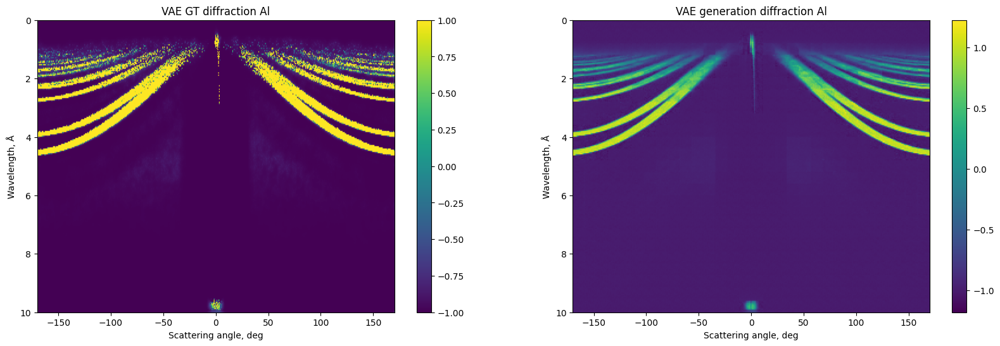

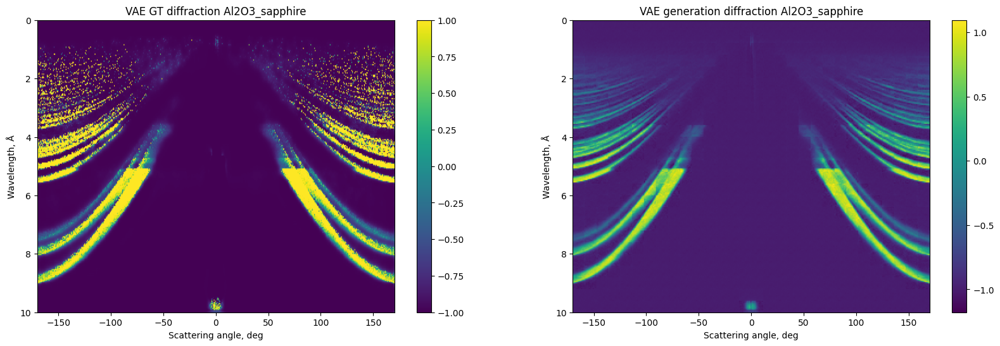

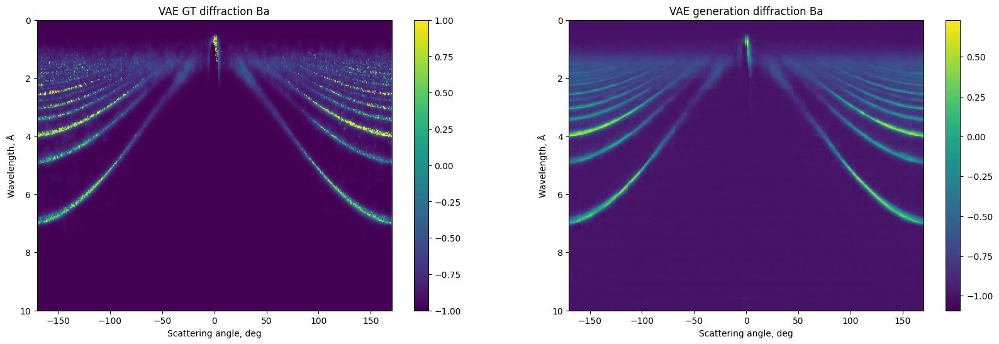

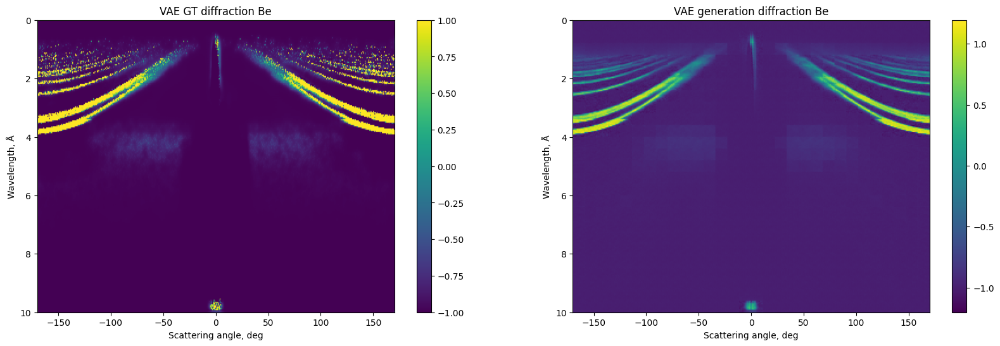

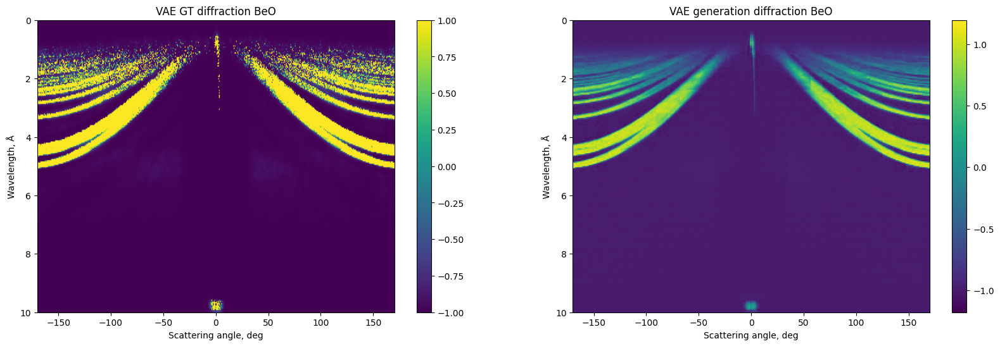

...

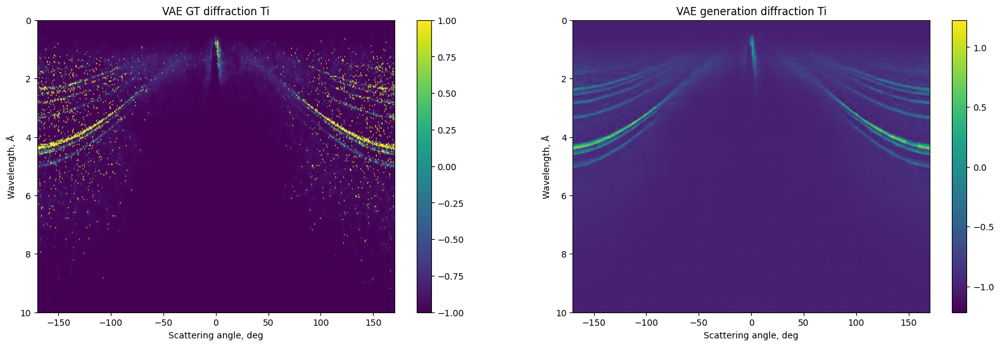

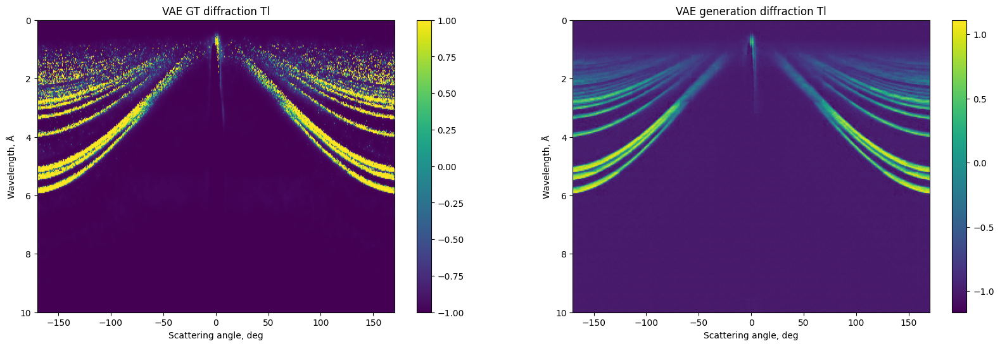

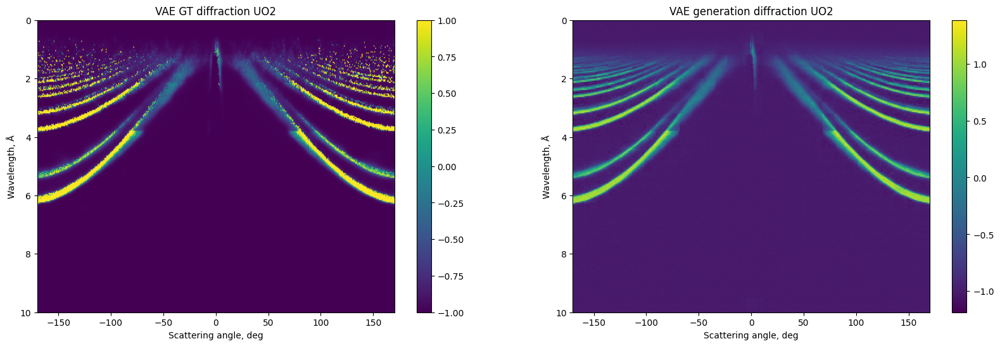

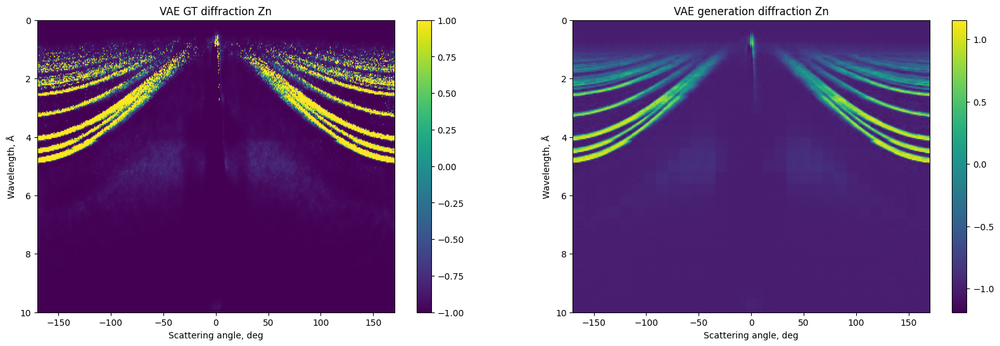

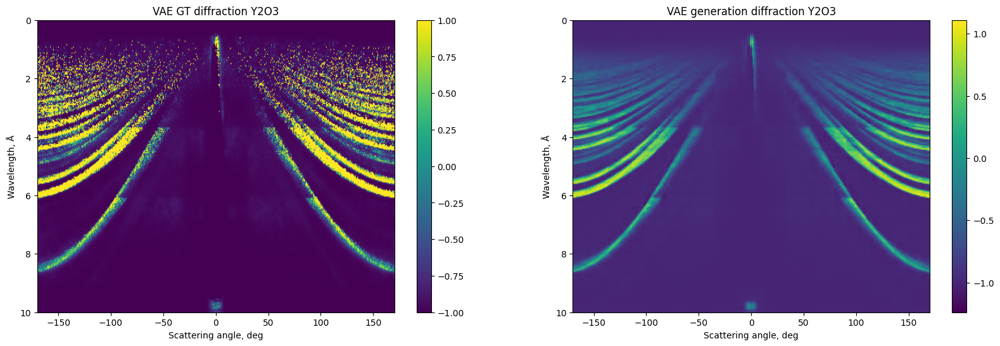

In [ ]:
import matplotlib.pyplot as plt

gt_diffractions = df_test_tensor.squeeze().cpu().numpy()


for i, (generated_diffraction, gt_diffraction) in enumerate(zip(generated, gt_diffractions)):
    # Создаем фигуру и оси
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 6))

    # Первый график
    im1 = ax1.imshow(gt_diffraction, cmap='viridis', aspect='auto', extent=(-170, 170, 10, 0))
    ax1.set_title(f"VAE GT diffraction {Crystal_tags.tolist()[i]}")
    ax1.set_xlabel('Scattering angle, deg')
    ax1.set_ylabel('Wavelength, Å')
    plt.colorbar(im1)

    # Первый график
    im2 = ax2.imshow(generated_diffraction.squeeze().cpu().numpy(), cmap='viridis', aspect='auto', extent=(-170, 170, 10, 0))
    ax2.set_title(f"VAE generation diffraction {Crystal_tags.tolist()[i]}")
    ax2.set_xlabel('Scattering angle, deg')
    ax2.set_ylabel('Wavelength, Å')
    plt.colorbar(im2)

    plt.savefig(f'VAE Results/{Crystal_tags.tolist()[i]} Diffraction VAE.jpg')

    plt.show()

Cr - Stats=1e8, Min Pulce: нашлось 1 записей
Cr - Stats=1e8, Max Pulce: нашлось 1 записей
Cr - Stats=5e8, Min Pulce: нашлось 1 записей
Cr - Stats=5e8, Max Pulce: нашлось 1 записей


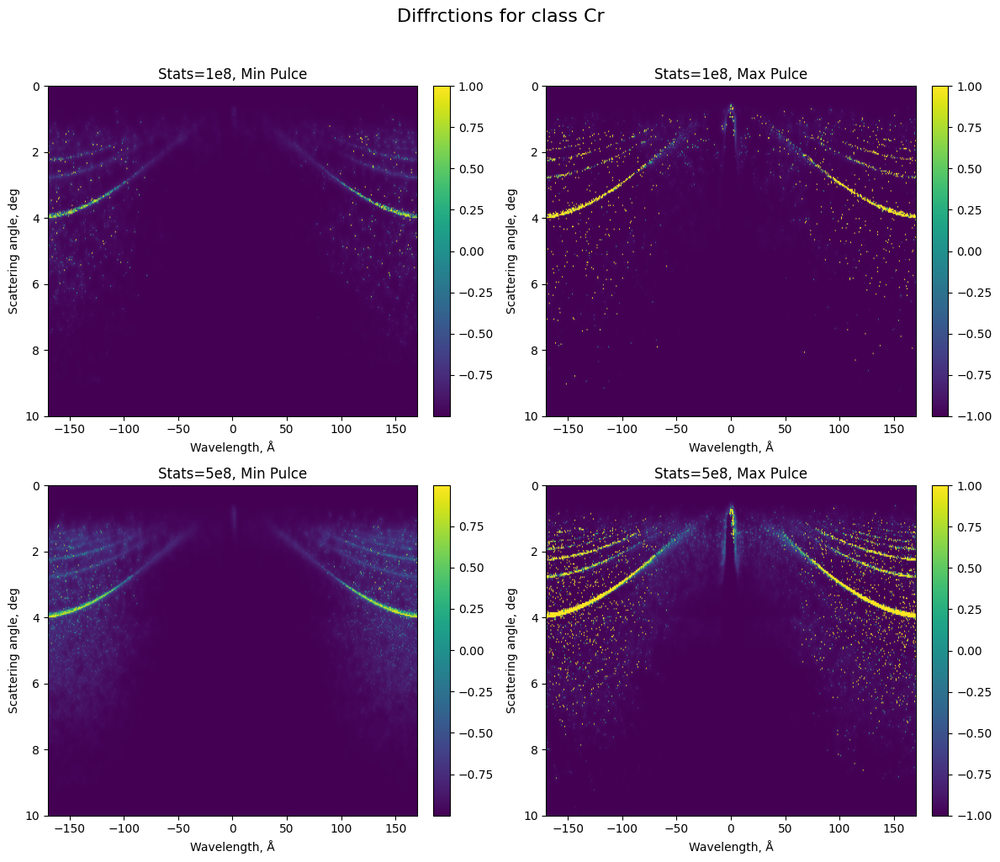

Fe - Stats=1e8, Min Pulce: нашлось 1 записей
Fe - Stats=1e8, Max Pulce: нашлось 1 записей
Fe - Stats=5e8, Min Pulce: нашлось 1 записей
Fe - Stats=5e8, Max Pulce: нашлось 1 записей


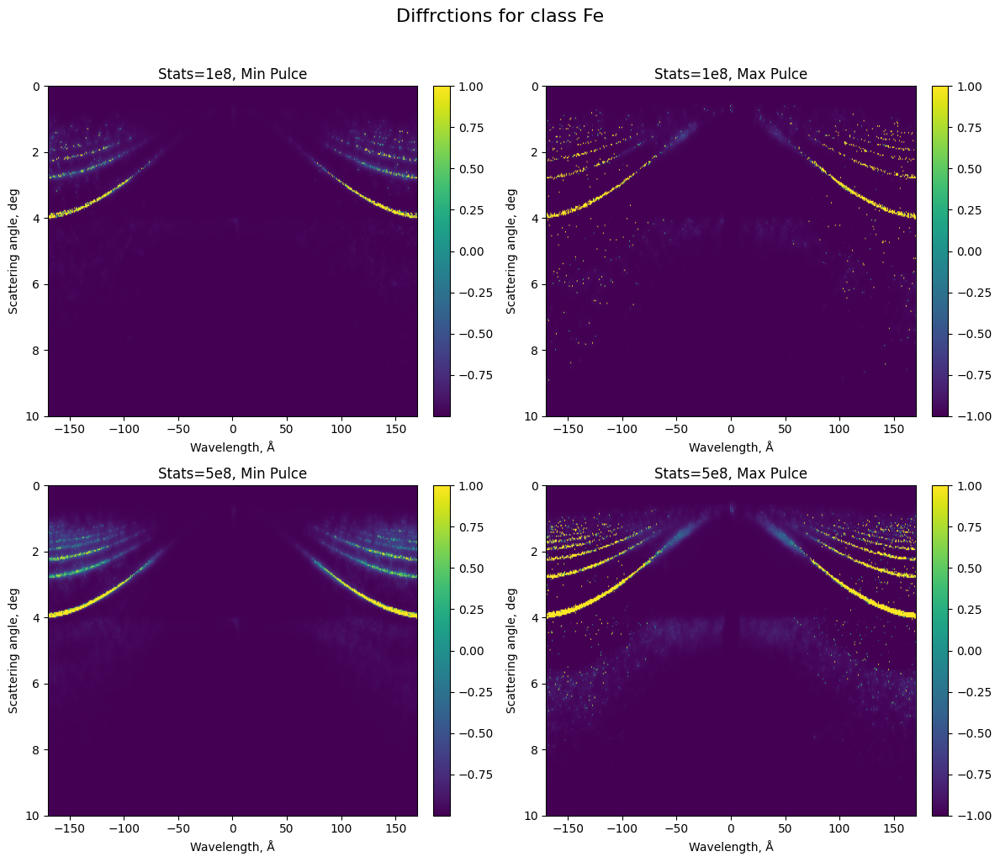

Ni - Stats=1e8, Min Pulce: нашлось 1 записей
Ni - Stats=1e8, Max Pulce: нашлось 1 записей
Ni - Stats=5e8, Min Pulce: нашлось 1 записей
Ni - Stats=5e8, Max Pulce: нашлось 1 записей


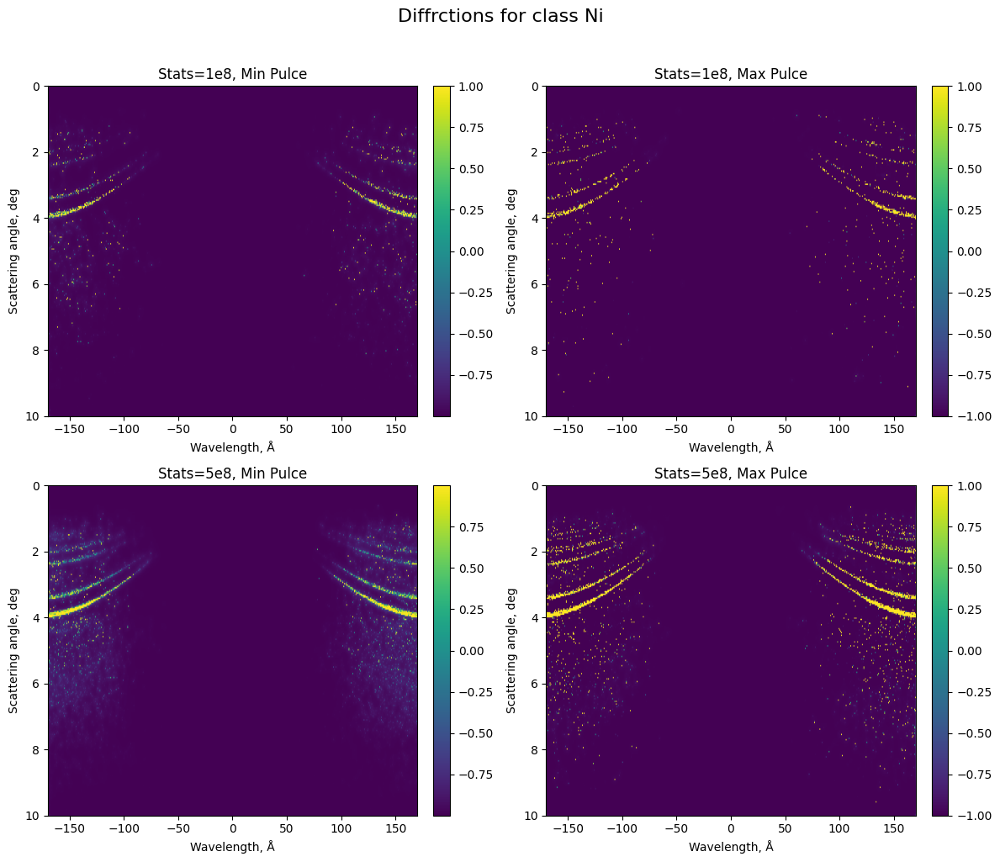

Ti - Stats=1e8, Min Pulce: нашлось 1 записей
Ti - Stats=1e8, Max Pulce: нашлось 1 записей
Ti - Stats=5e8, Min Pulce: нашлось 1 записей
Ti - Stats=5e8, Max Pulce: нашлось 1 записей


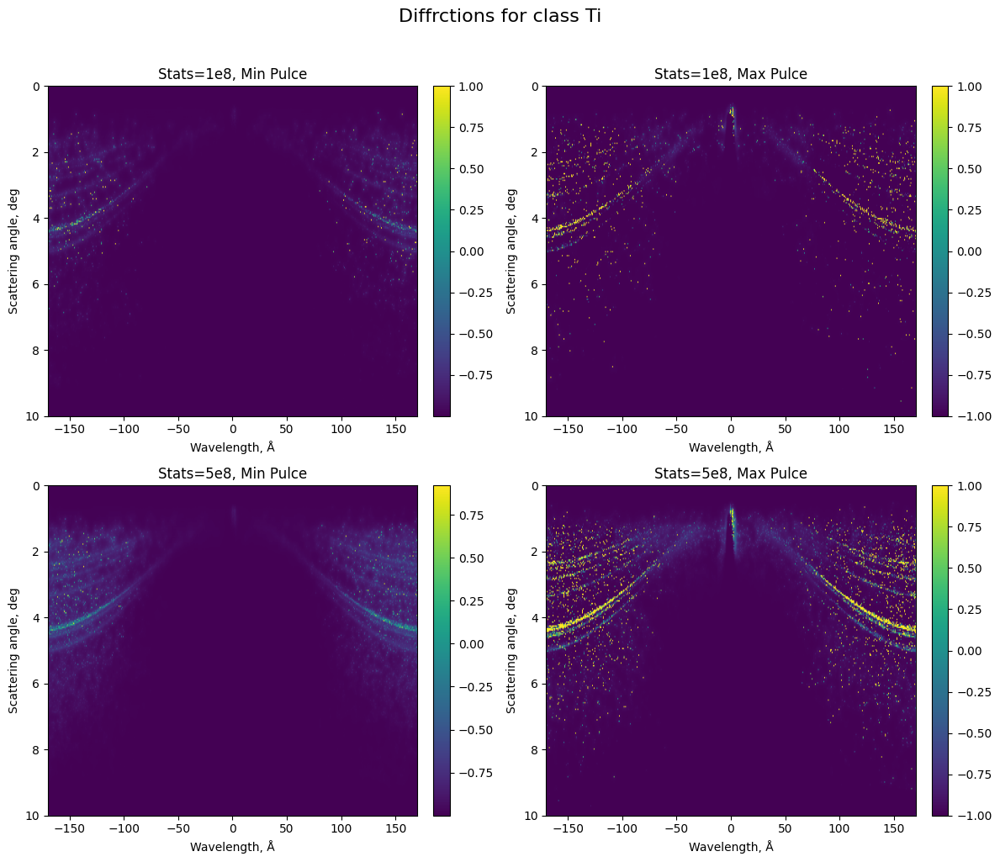

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Определяем интересующие нас классы
target_classes = ['Cr', 'Cu', 'Fe', 'Ni', 'Ti']

# Получаем уникальные значения Pulce duration
pulce_duration_values = df['Pulce duration'].unique()
min_pulce = min(pulce_duration_values)
max_pulce = max(pulce_duration_values)

# Параметры Stats
stats_values = [1.e+08, 5.e+08]

# Создаем отдельную фигуру для каждого класса
for crystal_class in target_classes:
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))
    fig.suptitle(f'Diffrctions for class {crystal_class}', fontsize=16, y=1.02)
    
    # Список параметров для каждого подграфика
    params = [
        (1.e+08, min_pulce, 'Stats=1e8, Min Pulce'),
        (1.e+08, max_pulce, 'Stats=1e8, Max Pulce'),
        (5.e+08, min_pulce, 'Stats=5e8, Min Pulce'),
        (5.e+08, max_pulce, 'Stats=5e8, Max Pulce')
    ]
    
    # Проходим по всем комбинациям параметров
    for idx, (stats, pulce, title) in enumerate(params):
        row = idx // 2
        col = idx % 2
        
        # Фильтруем данные
        filtered_df = df.loc[
            (df['Crystal'] == crystal_class) & 
            (df['Stats'] == stats) & 
            (df['Pulce duration'] == pulce)
        ]
        
        if len(filtered_df) == 0:
            print(f"Нет данных для {crystal_class}: {title}")
            axes[row, col].text(0.5, 0.5, 'Нет данных', 
                              ha='center', va='center',
                              transform=axes[row, col].transAxes)
            axes[row, col].set_title(title, fontsize=12)
            axes[row, col].axis('off')
            continue
        
        # Берем первую дифракцию
        diffraction_matrix = filtered_df['Matrix'].iloc[0]
        
        # Если матрица в тензоре PyTorch, преобразуем в numpy
        if isinstance(diffraction_matrix, torch.Tensor):
            diffraction_matrix = diffraction_matrix.cpu().numpy()
        
        # Визуализируем
        ax = axes[row, col]
        im = ax.imshow(diffraction_matrix*2-1, cmap='viridis', aspect='auto', extent=(-170, 170, 10, 0))
        
        # Добавляем цветовую шкалу
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        
        # Заголовок
        ax.set_title(title, fontsize=12)
        ax.set_xlabel('Wavelength, Å')
        ax.set_ylabel('Scattering angle, deg')
        
        print(f"{crystal_class} - {title}: нашлось {len(filtered_df)} записей")
    
    plt.tight_layout()
    plt.show()

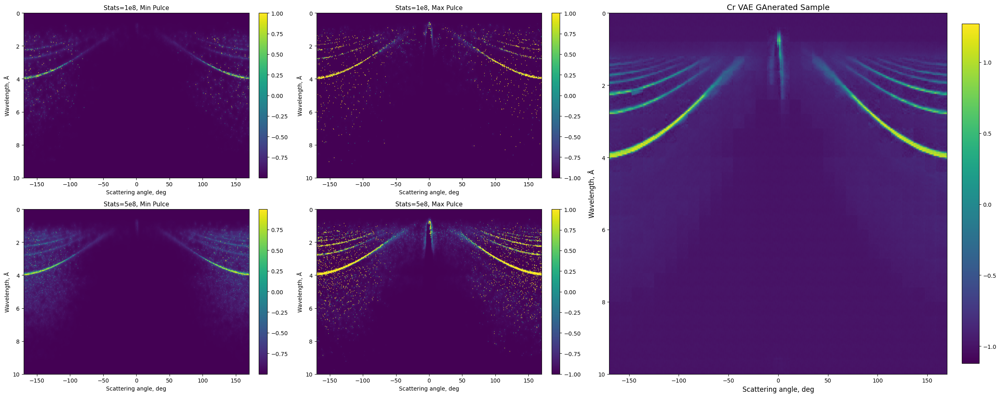

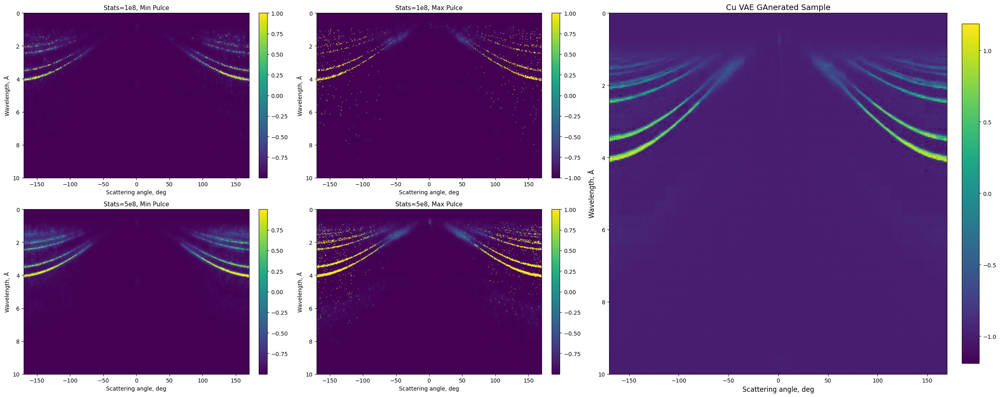

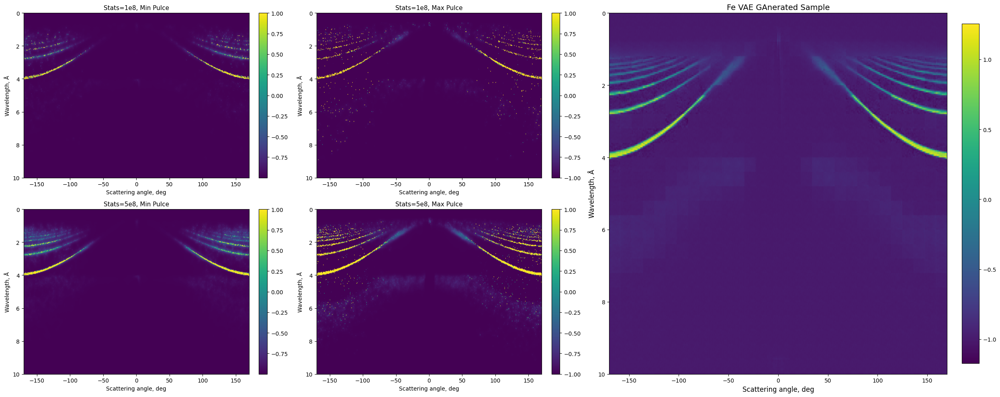

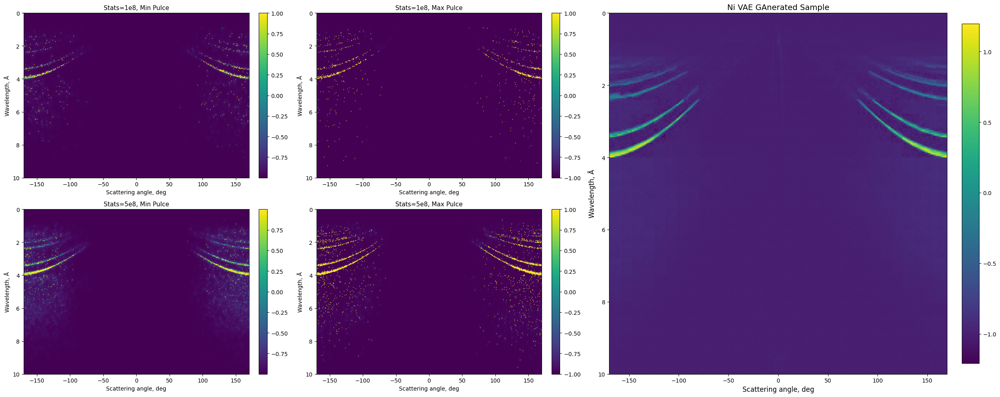

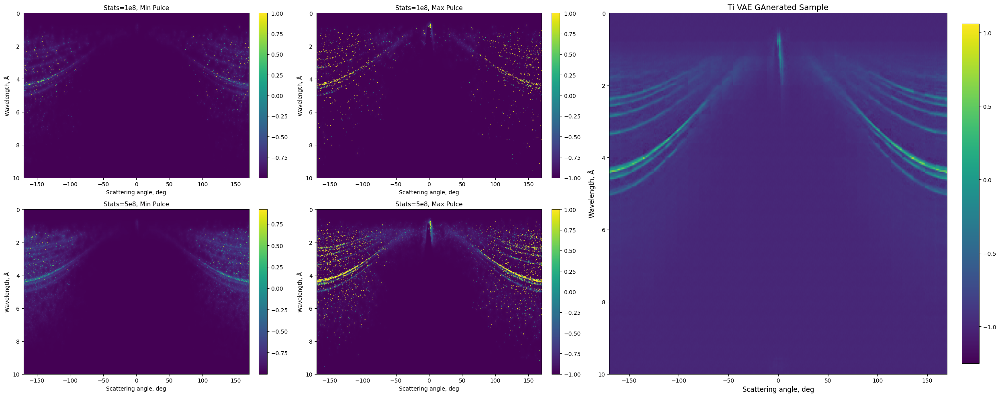

In [19]:
import matplotlib.pyplot as plt
import numpy as np

# Определяем интересующие нас классы
target_classes = ['Cr', 'Cu', 'Fe', 'Ni', 'Ti']

# Получаем уникальные значения Pulce duration
pulce_duration_values = df['Pulce duration'].unique()
min_pulce = min(pulce_duration_values)
max_pulce = max(pulce_duration_values)

# Для каждого класса создаем свою фигуру
for i , crystal_class in enumerate(target_classes):
    # Создаем GridSpec: 2 строки, 3 колонки
    # 4 маленьких графика (2x2) + 1 большой справа
    fig = plt.figure(figsize=(25, 10))
    gs = plt.GridSpec(2, 3, width_ratios=[1, 1, 1.5], height_ratios=[1, 1])
    
    # Список параметров для маленьких графиков
    params = [
        (1.e+08, min_pulce, 'Stats=1e8, Min Pulce'),
        (1.e+08, max_pulce, 'Stats=1e8, Max Pulce'),
        (5.e+08, min_pulce, 'Stats=5e8, Min Pulce'),
        (5.e+08, max_pulce, 'Stats=5e8, Max Pulce')
    ]
    
    # Создаем 4 маленьких графика
    for idx, (stats, pulce, title) in enumerate(params):
        row = idx // 2
        col = idx % 2
        ax = fig.add_subplot(gs[row, col])
        
        # Фильтруем данные
        filtered_df = df.loc[
            (df['Crystal'] == crystal_class) & 
            (df['Stats'] == stats) & 
            (df['Pulce duration'] == pulce)
        ]
        
        if len(filtered_df) == 0:
            ax.text(0.5, 0.5, 'Нет данных', 
                   ha='center', va='center',
                   transform=ax.transAxes)
            ax.set_title(title, fontsize=11)
            ax.axis('off')
            continue
        
        # Берем первую дифракцию
        diffraction_matrix = filtered_df['Matrix'].iloc[0]
        
        # Если матрица в тензоре PyTorch, преобразуем в numpy
        if isinstance(diffraction_matrix, torch.Tensor):
            diffraction_matrix = diffraction_matrix.cpu().numpy()
        
        # Визуализируем
        im = ax.imshow(diffraction_matrix*2-1, cmap='viridis', aspect='auto', extent=(-170, 170, 10, 0))
        plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)
        ax.set_title(title, fontsize=11)
        ax.set_xlabel('Scattering angle, deg')
        ax.set_ylabel('Wavelength, Å')
    
    # Создаем большой график справа (занимает обе строки, 3-ю колонку)
    ax_big = fig.add_subplot(gs[:, 2])  # : означает все строки
    
    # Визуализируем в большом графике
    im_big = ax_big.imshow(special_generated_diffractions[i].squeeze().cpu().numpy(), cmap='viridis', aspect='auto', extent=(-170, 170, 10, 0))
    plt.colorbar(im_big, ax=ax_big, fraction=0.046, pad=0.04)
    

    ax_big.set_title(f'{crystal_class} VAE GAnerated Sample', 
                    fontsize=14)
    
    ax_big.set_xlabel('Scattering angle, deg', fontsize=12)
    ax_big.set_ylabel('Wavelength, Å', fontsize=12)
    
    plt.tight_layout()
    plt.show()

In [22]:
import torch

class Qwrapper:
    def __init__(self, theta_range=(-170, 170), L_range=(0.1, 10), fixed_centers=None, device="cuda"):
        self.theta_range = theta_range
        self.L_range = L_range
        self.device = device

        if fixed_centers is None:
            raise ValueError("Нужно передать фиксированные центры каналов d.")

        centers = torch.tensor(fixed_centers, dtype=torch.float32)
        self.centers = centers.to(device)

        # Строим границы каналов
        edges = torch.zeros(len(centers) + 1, dtype=torch.float32)

        edges[1:-1] = (centers[:-1] + centers[1:]) * 0.5
        edges[0] = centers[0] - (centers[1] - centers[0]) * 0.5
        edges[-1] = centers[-1] + (centers[-1] - centers[-2]) * 0.5

        self.edges = edges.to(device)


    def tensor_to_d(self, batch_tensor):
        if batch_tensor.dim() != 4:
            raise ValueError("Ожидается тензор размера [B, 1, H, W]")

        B, _, H, W = batch_tensor.shape
        batch_tensor = batch_tensor.to(self.device)

        # формируем theta и L (Правильно!)
        theta_deg = torch.linspace(self.theta_range[0], self.theta_range[1], W, device=self.device)
        L_vals = torch.linspace(self.L_range[0], self.L_range[1], H, device=self.device)

        theta_rad = torch.deg2rad(theta_deg)  # [W]

        # meshgrid правильно: (H, W)
        # L зависит от строки, theta зависит от столбца
        L_grid, theta_grid = torch.meshgrid(L_vals, theta_rad, indexing="ij")
        # теперь:
        # L_grid:     [H, W]
        # theta_grid: [H, W]

        # вычисляем d
        d_grid = L_grid / (2 * torch.sin(torch.abs(theta_grid) * 0.5))

        # маска d <= 7.5
        mask = d_grid <= 7.5  # [H, W]

        results = []

        for b in range(B):
            I_mat = batch_tensor[b, 0]  # [H, W]

            # применяем маску
            d_vals = d_grid[mask]       # [N]
            I_vals = I_mat[mask]        # [N]

            # определяем индекс канала
            idx = torch.bucketize(d_vals, self.edges) - 1

            I_summed = torch.zeros(len(self.centers), device=self.device)
            I_summed.scatter_add_(0, idx.clamp(0, len(I_summed) - 1), I_vals)

            results.append({
                "d": self.centers.detach().cpu().numpy(),
                "I": I_summed.detach().cpu().numpy()
            })

        return results


Данные для Cr сохранены в файл: VAE_tests_diffraction_data_d_space/Cr_diffraction_data.csv


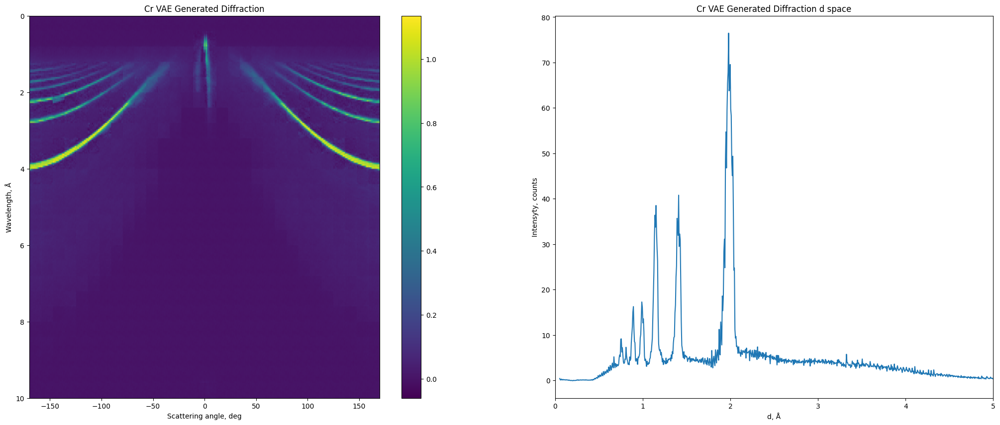

Данные для Cu сохранены в файл: VAE_tests_diffraction_data_d_space/Cu_diffraction_data.csv


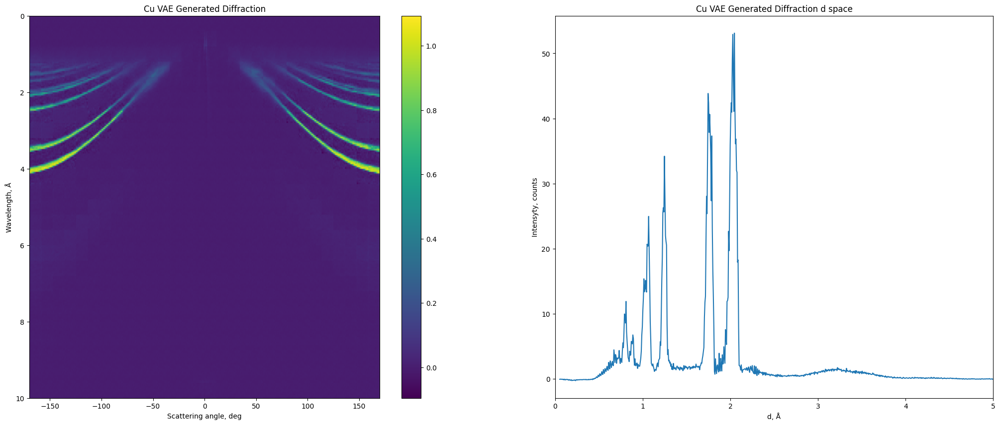

Данные для Fe сохранены в файл: VAE_tests_diffraction_data_d_space/Fe_diffraction_data.csv


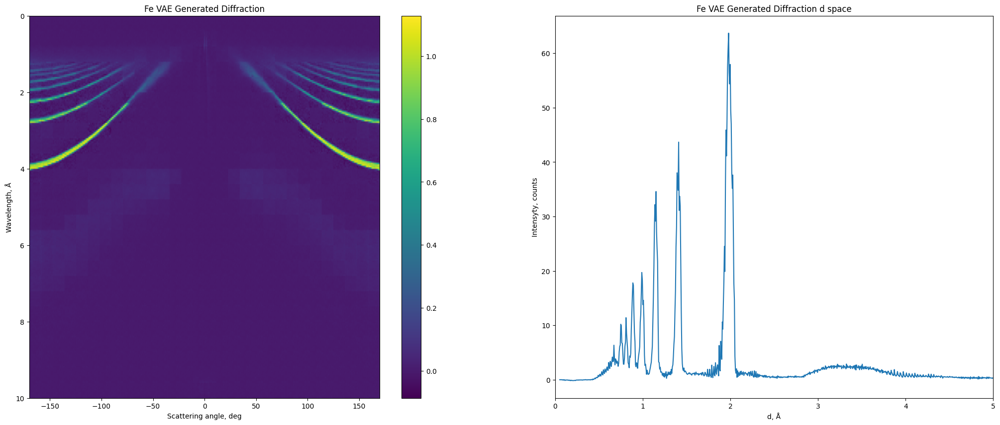

Данные для Ni сохранены в файл: VAE_tests_diffraction_data_d_space/Ni_diffraction_data.csv


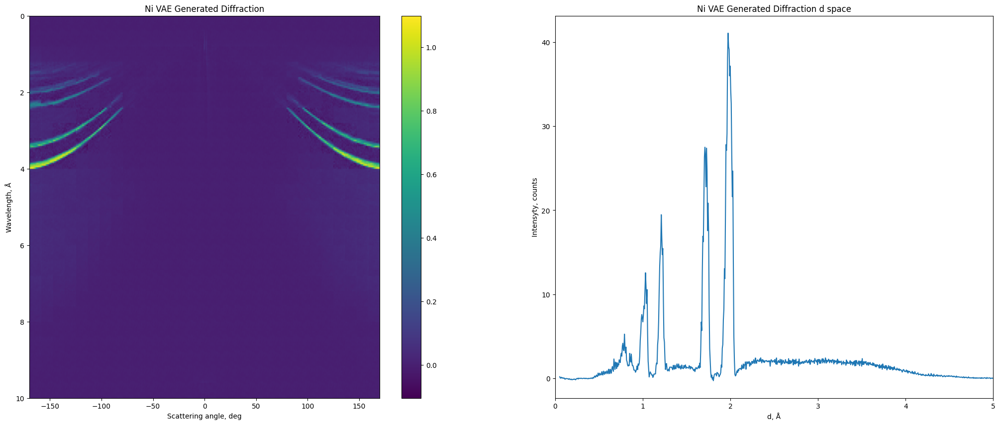

Данные для Ti сохранены в файл: VAE_tests_diffraction_data_d_space/Ti_diffraction_data.csv


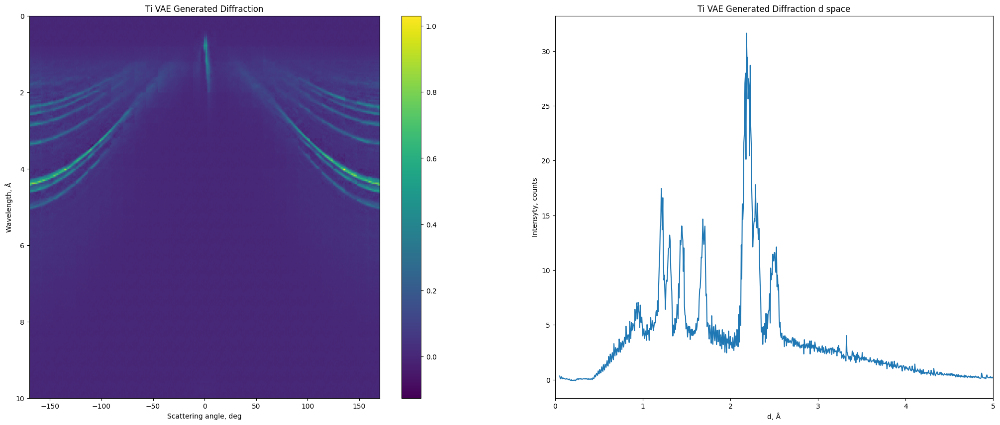

In [27]:
import pandas as pd
import os

def denorm(x):
    return (x + 1) / 2

# Определяем интересующие нас классы
target_classes = ['Cr', 'Cu', 'Fe', 'Ni', 'Ti']

fixed_centers = np.linspace(0.05318052, 7.49710258, 1241)

qw = Qwrapper(
    theta_range=(-170, 170),
    L_range=(0.1, 10),
    fixed_centers=fixed_centers,
    device = "cpu"
)

# Создаем папку для сохранения данных, если она не существует
output_dir = "VAE_tests_diffraction_data_d_space"
os.makedirs(output_dir, exist_ok=True)

for i, diffraction in enumerate(special_generated_diffractions):
    # Проверяем, что индекс не выходит за пределы списка классов
    if i >= len(target_classes):
        print(f"Внимание: индекс {i} превышает количество классов. Использую общее имя.")
        class_name = f"Class_{i}"
    else:
        class_name = target_classes[i]

    denorm_diffraction = denorm(diffraction)

    out_d_space = qw.tensor_to_d(denorm_diffraction)

    # Сохраняем данные в CSV файл
    df_to_save = pd.DataFrame({
        'd_A': out_d_space[0]["d"],  # d в ангстремах
        'Intensity': out_d_space[0]["I"]  # Интенсивность
    })
    
    # Создаем имя файла
    filename = f"{output_dir}/{class_name}_diffraction_data.csv"
    
    # Сохраняем в CSV
    df_to_save.to_csv(filename, index=False)
    print(f"Данные для {class_name} сохранены в файл: {filename}")

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(25, 10))

    # Первый график
    im1 = ax1.imshow(denorm_diffraction.squeeze().cpu().numpy(), cmap='viridis', aspect='auto', extent=(-170, 170, 10, 0))
    ax1.set_title(f'{target_classes[i]} VAE Generated Diffraction')
    ax1.set_xlabel('Scattering angle, deg')
    ax1.set_ylabel('Wavelength, Å')
    plt.colorbar(im1)

    ax2.plot(out_d_space[0]["d"], out_d_space[0]["I"])
    ax2.set_xlim(0, 5)
    #ax4.set_yscale('log')
    ax2.set_title(f"{target_classes[i]} VAE Generated Diffraction d space")
    ax2.set_xlabel('d, Å')
    ax2.set_ylabel('Intensyty, counts')

    plt.show()

    


In [27]:
from peak_loss import Qwrapper, extract_peak_region
import torch
import numpy as np
from scipy.signal import find_peaks
import math

def find_peaks_for_batch(batch_DI,
                         height=0.05,
                         distance=10,
                         prominence=0.1,
                         width=5,
                         scale_factor=1.5,
                         default_window=15,
                         scale=False):

    batch_results = []

    for sample in batch_DI:
        d = sample["d"]
        I = sample["I"] / 4 if scale else sample["I"]

        peaks, properties = find_peaks(
            I,
            height=height,
            distance=distance,
            prominence=prominence,
            width=width
        )

        sample_peaks = []
        for peak_idx in peaks:
            d_window, I_window = extract_peak_region(
                d, I, peak_idx, peaks, properties,
                scale_factor, default_window
            )

            integral_intensity = float(np.sum(I_window))
            max_intensity = float(I[peak_idx])
            com = np.sum(d_window * I_window) / np.sum(I_window)

            # FWHM через scipy (индексное, но для относительной разности ок)
            if "widths" in properties:
                fwhm = float(properties["widths"][np.where(peaks == peak_idx)[0][0]])
            else:
                fwhm = np.nan

            sample_peaks.append({
                "d": float(d[peak_idx]),
                "d_com": float(com),
                "integral_intensity": integral_intensity,
                "max_intensity": max_intensity,
                "profile_d": d_window,
                "profile_I": I_window
            })

        batch_results.append(sample_peaks)

    return batch_results

def normalize_profile(I):
    s = np.sum(I)
    if s <= 0:
        return None
    return I / s

def resample_profile(d, I, d_center, x_ref):
    """
    d        : массив d
    I        : интенсивность
    d_center : центр пика
    x_ref    : общая относительная сетка
    """
    x = (d - d_center) / d_center
    I_norm = normalize_profile(I)
    if I_norm is None:
        return None

    return np.interp(x_ref, x, I_norm, left=0.0, right=0.0)

def emd_1d(p, q, dx):
    """
    p, q : нормированные 1D распределения (sum = 1)
    dx   : шаг сетки
    """
    cdf_p = np.cumsum(p)
    cdf_q = np.cumsum(q)
    return np.sum(np.abs(cdf_p - cdf_q)) * dx

def emd_shape_loss(peak1, peak2,
                   x_ref,
                   eps=1e-12):
    """
    peak1, peak2 — словари пиков
    peak["d"], peak["profile_d"], peak["profile_I"]
    """

    p1 = resample_profile(
        peak1["profile_d"],
        peak1["profile_I"],
        peak1["d"],
        x_ref
    )
    p2 = resample_profile(
        peak2["profile_d"],
        peak2["profile_I"],
        peak2["d"],
        x_ref
    )

    if p1 is None or p2 is None:
        return 0.0

    # защита от численного мусора
    p1 = np.maximum(p1, 0)
    p2 = np.maximum(p2, 0)

    p1 /= (np.sum(p1) + eps)
    p2 /= (np.sum(p2) + eps)

    dx = x_ref[1] - x_ref[0]

    return emd_1d(p1, p2, dx)


# -------------------------------
# 3) Peak matching loss
# -------------------------------
def peak_matching_loss(batch_pred, batch_true, tol=0.05):
    total_loss_Iint = 0.0
    total_loss_Imax = 0.0
    total_loss_shape = 0.0

    for pred_peaks, true_peaks in zip(batch_pred, batch_true):

        if len(pred_peaks) == 0 or len(true_peaks) == 0:
            continue

        for p1 in pred_peaks:
            d1 = p1["d_com"]
            Iint1 = p1["integral_intensity"]
            Imax1 = p1["max_intensity"]

            p2 = min(true_peaks, key=lambda p: abs(p["d"] - d1))
            d2 = p2["d_com"]

            if abs(d1 - d2) > tol:
                continue

            Iint2 = p2["integral_intensity"]
            Imax2 = p2["max_intensity"]

            # 🔒 Безопасный лог
            Iint1_safe = max(Iint1, 0)
            Iint2_safe = max(Iint2, 0)
            Imax1_safe = max(Imax1, 0)
            Imax2_safe = max(Imax2, 0)

            # 1) Интегральная интенсивность
            loss_Iint = (math.log(Iint1_safe + 1) - math.log(Iint2_safe + 1))**2

            # 2) Максимальная интенсивность
            loss_Imax = (math.log(Imax1_safe + 1) - math.log(Imax2_safe + 1))**2

            x_ref = np.linspace(-0.03, 0.03, 64)
            loss_shape = emd_shape_loss(p1, p2, x_ref)

            total_loss_Iint += loss_Iint
            total_loss_Imax += loss_Imax
            total_loss_shape += loss_shape

    return {'Integral Intensity': total_loss_Iint,
            'Peak Intensity': total_loss_Imax,
            'shape': total_loss_shape,
            }




# ============================================================
# 4) Единый ООП-класс для всего пайплайна
# ============================================================
class DiffractionPipeline:
    def __init__(self,
                 fixed_centers_pred,
                 fixed_centers_true,
                 theta_range=(-170, 170),
                 L_range=(0.1, 10),
                 device="cuda"):

        self.device = device

        self.qw_pred = Qwrapper(theta_range, L_range, fixed_centers_pred, device)
        self.qw_true = Qwrapper(theta_range, L_range, fixed_centers_true, device)

    def __call__(self,
                 batch_pred_2d,
                 batch_true_2d,
                 peak_params_pred={},
                 peak_params_true={},
                 tol=0.05):

        # 1D проекции
        pred_DI = self.qw_pred.tensor_to_d(batch_pred_2d)
        true_DI = self.qw_true.tensor_to_d(batch_true_2d)

        # Пики
        pred_peaks = find_peaks_for_batch(pred_DI, **peak_params_pred)
        true_peaks = find_peaks_for_batch(true_DI, **peak_params_true)

        # Лосс
        return peak_matching_loss(pred_peaks, true_peaks, tol)

fixed_centers_hr = np.linspace(0.05318052, 7.49710258, 1241)
fixed_centers_lr = np.linspace(0.0546658, 7.49180085, 832)

pipe = DiffractionPipeline(
    fixed_centers_pred=fixed_centers_hr,
    fixed_centers_true=fixed_centers_lr,
    device=device
)

In [28]:
import torch
from tqdm import tqdm
import torch.nn.functional as F

def denorm(x):
    return (x + 1) / 2

# Validation
model.eval()
Integral_Intensity_losses = []
Peak_Intensity_losses = []
Shape_losses = []

with torch.no_grad():
    for data, labels in tqdm(train_loader):

        data = data.to(device)
        labels = labels.to(device)

        # Sample from prior distribution
        z = torch.randn(data.size(0), 32, 25, 30).to(device)
        generated = model.decoder(z, labels)

        # ---- denorm ----
        data_01 = denorm(data).clamp(0, 1)
        gen_01  = denorm(generated).clamp(0, 1)


        loss_peaks = pipe(
            batch_pred_2d=gen_01,     # предсказанная 2D дифракция
            batch_true_2d=data_01,     # ground-truth 2D
            peak_params_pred={"scale": False},
            peak_params_true={"scale": False},
            tol=0.05
        )

        Integral_Intensity_losses.append(loss_peaks['Integral Intensity'])
        Peak_Intensity_losses.append(loss_peaks['Peak Intensity'])
        Shape_losses.append(loss_peaks['shape'])

100%|██████████| 432/432 [00:03<00:00, 120.90it/s]


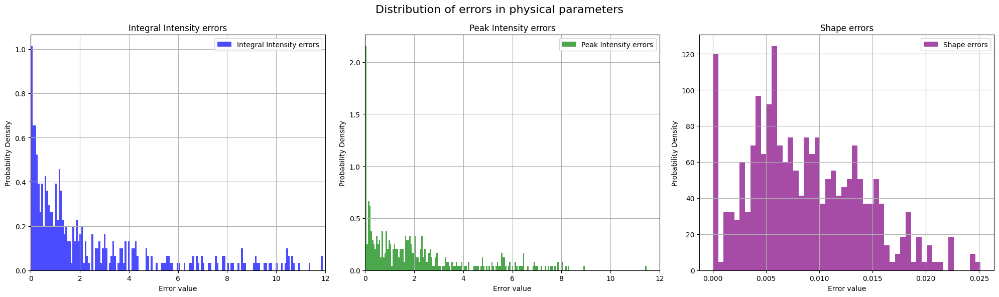

In [29]:
import matplotlib.pyplot as plt
import numpy as np

# Предполагаем, что массивы уже созданы
# Integral_Intensity_losses, Peak_Intensity_losses, d_losses, Shape_losses

# Создаем фигуру с 4 subplots
fig, axes = plt.subplots(1, 3, figsize=(20, 6))
fig.suptitle('Distribution of errors in physical parameters', fontsize=16)

# Список массивов данных
data_arrays = [Integral_Intensity_losses, Peak_Intensity_losses, Shape_losses]
titles = [
    "Integral Intensity errors",
    "Peak Intensity errors", 
    "Shape errors"
]
xlabels = ["Error value"] * 4
colors = ['blue', 'green', 'purple']  # Разные цвета для каждой гистограммы
bins = [300, 300, 50]
limits = [[0, 12], [0, 12], None, None]

# Функция для построения одной гистограммы
def plot_histogram(ax, data, title, xlabel, color, bins, limits):
    ax.hist(data, alpha=0.7, bins=bins, density=True, color=color, label=title)
    if limits:
        ax.set_xlim(limits[0], limits[1])
    ax.set_xlabel(xlabel)
    ax.set_ylabel("Probability Density")
    ax.set_title(title)
    ax.legend()
    ax.grid(True)

# Построение всех 4 гистограмм
for i, ax in enumerate(axes.flat):
    plot_histogram(ax, data_arrays[i], titles[i], xlabels[i], colors[i], bins[i], limits[i])

plt.tight_layout()
plt.show()

In [30]:
import json

with open("ViT VAE/Conditional_ViT_VAE_physycal_metrics_results.json", "w", encoding="utf-8") as f:
    json.dump(
        {
            "Integral Intensity losses": Integral_Intensity_losses,
            "Peak Intensity losses": Peak_Intensity_losses,
            "Shape_losses": Shape_losses
        },
        f,
        indent=4,
        ensure_ascii=False
    )